In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
# -----------------------------------
# Install Necessary Libraries
# -----------------------------------
!pip install tweet-preprocessor bertopic nltk emoji transformers spacy geopy hdbscan umap-learn contractions pyLDAvis
!python -m spacy download en_core_web_sm

# -----------------------------------
# Import Libraries
# -----------------------------------

# General Utilities
import os
import re
import html
import numpy as np
import pandas as pd
from tqdm import tqdm
tqdm.pandas()  # For progress bars

# Natural Language Processing (NLP)
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import contractions
import spacy
import preprocessor as p
from gensim.corpora import Dictionary
from gensim.models.coherencemodel import CoherenceModel
from gensim.models import LdaModel

# BERTopic and Vectorization
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired
from bertopic.vectorizers import ClassTfidfTransformer
from sentence_transformers import SentenceTransformer

# Dimensionality Reduction and Clustering
from umap import UMAP
from hdbscan import HDBSCAN

# Transformers for Sentiment Analysis
import torch
from transformers import pipeline

# Geospatial Analysis
from geopy.geocoders import Nominatim
import folium  # Map visualization

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import pyLDAvis
import pyLDAvis.gensim_models

# Machine Learning Metrics
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# -----------------------------------
# Setup NLTK Resources
# -----------------------------------
nltk.download('stopwords')
nltk.download('wordnet')
stopwords_en = set(stopwords.words('english')).union({'like', 'just', 'get', 'got'})
lemmatizer = WordNetLemmatizer()


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.7/143.7 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 586.9/586.9 kB 46.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 103.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 86.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 29.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.7/110.7 kB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 105.7 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecti

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


In [8]:
data = pd.read_csv('/content/drive/MyDrive/sapoliceservice_tweets.tsv', delimiter='\t')


p.set_options(p.OPT.URL, p.OPT.EMOJI, p.OPT.MENTION, p.OPT.SMILEY, p.OPT.NUMBER)
nlp = spacy.load("en_core_web_sm")
geolocator = Nominatim(user_agent="geo_extractor")

# Define text cleaning function
def clean_text(text):
    cleaned = p.clean(text)  # tweet-preprocessor
    cleaned = contractions.fix(cleaned)  #  contractions
    cleaned = re.sub(r'#', '', cleaned)  #  hashtags
    cleaned = re.sub(r'[^\w\s]', '', cleaned)  #  punctuation
    cleaned = re.sub(r'\s+', ' ', cleaned)  #  extra whitespace
    cleaned = re.sub(r"https?://\S+|www\.\S+", "", cleaned)  #  URLs
    cleaned = re.sub(r"@\w+", "", cleaned)  #  mentions
    cleaned = html.unescape(cleaned)  #  HTML
    return cleaned.lower().strip()

def remove_stopwords_and_lemmatize(text):
    return ' '.join([lemmatizer.lemmatize(word) for word in text.split() if word not in stopwords_en])


data['text_clean'] = data['text'].apply(clean_text).apply(remove_stopwords_and_lemmatize)

umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.1, metric='cosine') #(Modular build, pararms can be changed)
hdbscan_model = HDBSCAN(min_cluster_size=10, metric='euclidean', cluster_selection_method='eom', prediction_data=True) #(Modular build, pararms can be changed)
vectorizer_model = CountVectorizer(stop_words=list(stopwords_en), ngram_range=(1, 2))  # Including bigrams (Could be changed to suit the need, for the experiment I made use of Bigrams to capute words togehter, hoping for more meaning)
embedding_model = SentenceTransformer("all-MiniLM-L6-v2") #can make use of another pretrained model
ctfidf_model = ClassTfidfTransformer()
representation_model = KeyBERTInspired()

# Initialize BERTopic model
topic_model = BERTopic(
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model,
    ctfidf_model=ctfidf_model,
    representation_model=representation_model
)

# Filter for English tweets and copy data
data_en = data[data['lang'] == 'en'].copy()

# Batch process for topic modeling to avoid memory overload
all_topics, all_probabilities = [], []
batch_size = 50000

for i in tqdm(range(0, len(data_en), batch_size)):
    data_batch = data_en['text_clean'].iloc[i : i + batch_size]
    topics, probabilities = topic_model.fit_transform(data_batch.tolist())
    all_topics.extend(topics)
    all_probabilities.extend(probabilities)


data_en['topic'] = all_topics
data_en['topic_probability'] = all_probabilities


unclassified_tweets = data_en[data_en['topic'] == -1]

data_en['topic'] = all_topics
data_en['topic_probability'] = all_probabilities
data_en.to_parquet('/content/drive/My Drive/sapoliceservice_topics_latest_1.parquet')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

100%|██████████| 29/29 [1:00:53<00:00, 125.98s/it]


In [9]:

if len(unclassified_tweets) > 0:
    unclassified_texts = unclassified_tweets['text_clean'].tolist()
    refined_umap_model = UMAP(n_neighbors=5, n_components=5, min_dist=0.1, metric='cosine')
    refined_hdbscan_model = HDBSCAN(min_cluster_size=5, metric='euclidean', cluster_selection_method='leaf')


    refined_topic_model = BERTopic(
        embedding_model=embedding_model,
        umap_model=refined_umap_model,
        hdbscan_model=refined_hdbscan_model,
        vectorizer_model=vectorizer_model,
        ctfidf_model=ctfidf_model,
        representation_model=representation_model
    )

    refined_topics_all, refined_probabilities_all = [], []
    refined_batch_size = 10000

    for i in tqdm(range(0, len(unclassified_texts), refined_batch_size)):
        unclassified_batch = unclassified_texts[i : i + refined_batch_size]
        refined_topics, refined_probabilities = refined_topic_model.fit_transform(unclassified_batch)
        refined_topics_all.extend(refined_topics)
        refined_probabilities_all.extend(refined_probabilities)


    unclassified_tweets['refined_topic'] = refined_topics_all
    unclassified_tweets['refined_topic_probability'] = refined_probabilities_all

    unclassified_tweets.to_parquet('/content/drive/My Drive/sapoliceservice_topics_unclassified_tweets_latest_1.parquet')


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
100%|██████████| 29/29 [21:19<00:00, 44.13s/it]


In [10]:

processed_texts = data_en['text_clean'].apply(lambda x: x.split()).tolist()
dictionary = Dictionary(processed_texts)


topic_words = [
    [word for word, _ in topic_model.get_topic(topic_id)]
    for topic_id in topic_model.get_topics()
    if topic_id != -1  # Exclude the outlier topic (topic -1)
]


filtered_topics = [topic for topic in topic_words if len(topic) > 0]

if filtered_topics:
    topic_words_ids = [
        [dictionary.token2id[word] for word in topic if word in dictionary.token2id]
        for topic in filtered_topics
    ]
    topic_words_ids = [topic for topic in topic_words_ids if len(topic) > 0]

    if topic_words_ids:
        coherence_model_npmi = CoherenceModel(
            topics=topic_words_ids,
            texts=processed_texts,
            dictionary=dictionary,
            coherence='c_npmi'
        )
        topic_coherence_npmi = coherence_model_npmi.get_coherence()

        coherence_model_cv = CoherenceModel(
            topics=topic_words_ids,
            texts=processed_texts,
            dictionary=dictionary,
            coherence='c_v'
        )
        topic_coherence_cv = coherence_model_cv.get_coherence()

        print(f"Topic Coherence (NPMI): {topic_coherence_npmi if not np.isnan(topic_coherence_npmi) else 'N/A'}")
        print(f"Topic Coherence (c_v): {topic_coherence_cv}")

    else:
        print("No valid topics found for coherence calculation.")
else:
    print("No non-empty topics available.")

if filtered_topics:
    unique_words = set(word for topic in filtered_topics for word in topic)
    total_words = sum(len(topic) for topic in filtered_topics)
    topic_diversity = len(unique_words) / total_words
    print(f"Topic Diversity: {topic_diversity}")
else:
    print("No valid topics found for diversity calculation.")


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Topic Coherence (NPMI): N/A
Topic Coherence (c_v): 0.9010073353125911
Topic Diversity: 0.8453837597330367


In [11]:
# BERTopic intertopic distance
topic_model.visualize_topics()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [12]:
#BIgram topic word scores
topic_model.visualize_barchart()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



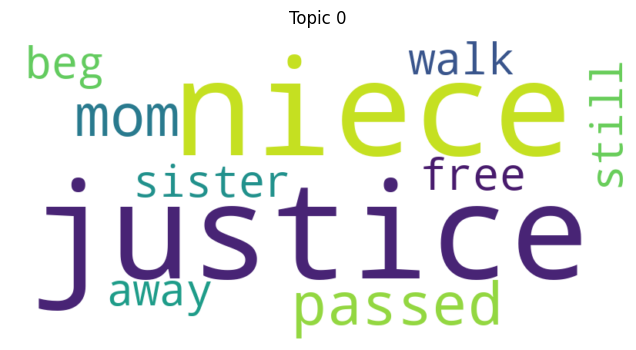

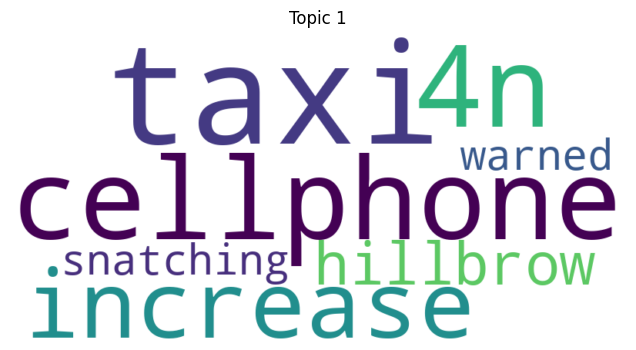

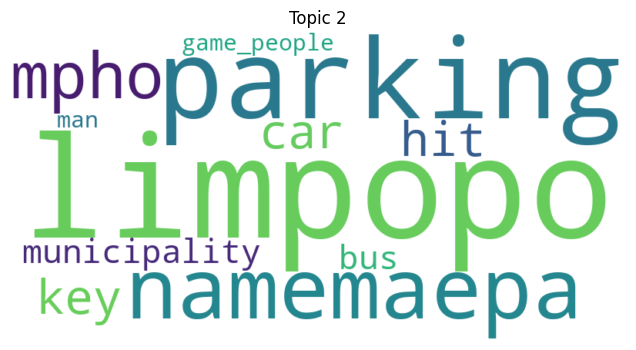

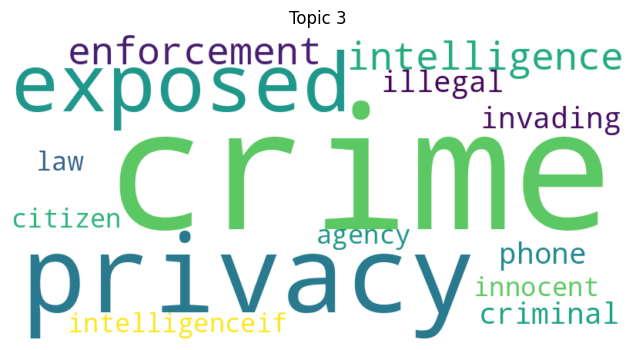

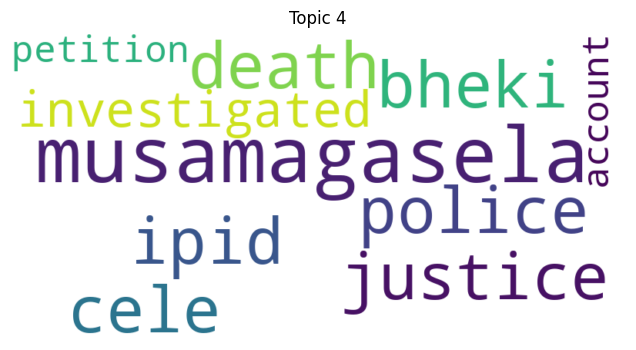

...

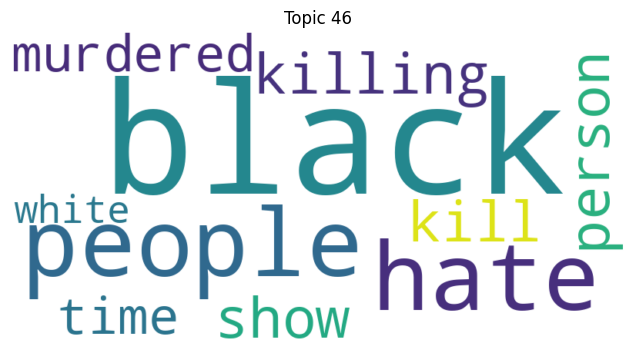

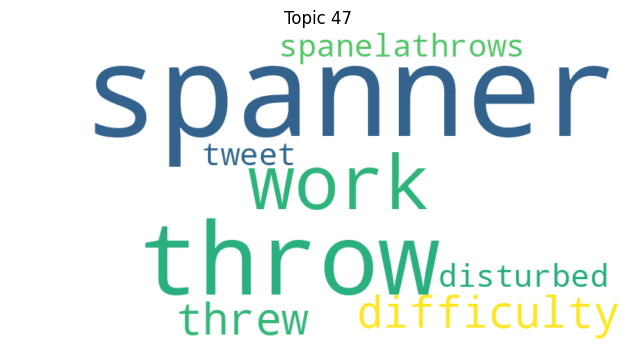

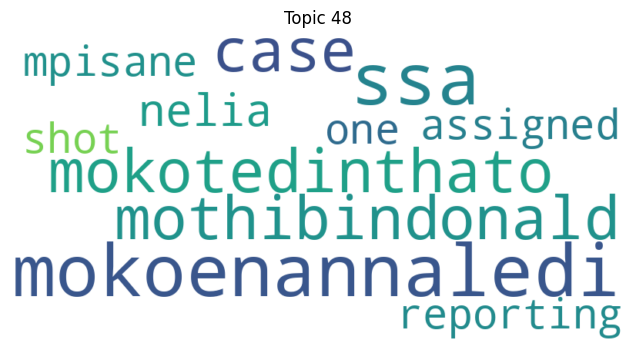

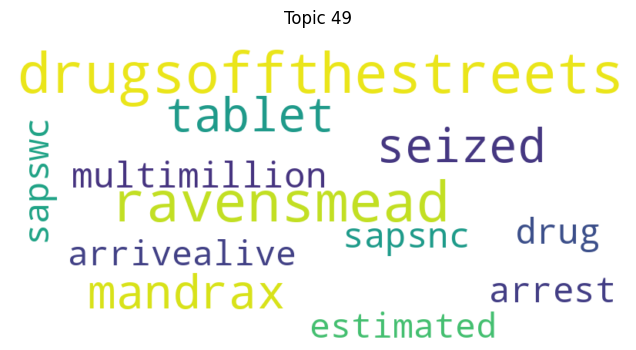

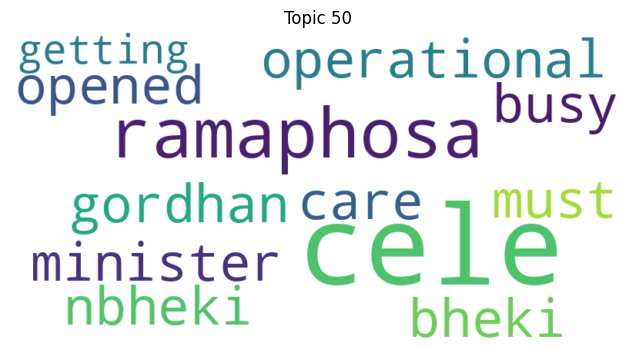

ValueError: We need at least 1 word to plot a word cloud, got 0.

In [13]:


# Generate and plot word clouds for each topic
for topic_id in range(len(topic_words)):
    words = " ".join(topic_words[topic_id])
    wordcloud = WordCloud(width=800, height=400, background_color="white").generate(words)

    plt.figure(figsize=(8, 4))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Topic {topic_id}")
    plt.show()


In [14]:
#LDA MODEL

dictionary = corpora.Dictionary([text.split() for text in data_en['text_clean']])

corpus = [dictionary.doc2bow(text.split()) for text in data_en['text_clean']]

lda_model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=10, passes=15, random_state=42)

# Initialize the Coherence Model
coherence_model_lda = CoherenceModel(model=lda_model, texts=[text.split() for text in data_en['text_clean']], dictionary=dictionary, coherence='c_v')

# Calculate the coherence score
coherence_score = coherence_model_lda.get_coherence()

# Print the coherence score
print(f"Coherence Score (c_v): {coherence_score}")


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Coherence Score (c_v): 0.43362268267487825


In [15]:
lda_vis = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary)

pyLDAvis.display(lda_vis)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [16]:
# Sentiment Analysis with RoBERTa
sentiment_pipeline = pipeline(
    "sentiment-analysis",
    model="cardiffnlp/twitter-roberta-base-sentiment-latest",
    device=0 if torch.cuda.is_available() else -1
)

all_sentiments, batch_size = [], 50000
for i in tqdm(range(0, len(data_en), batch_size)):
    batch = data_en['text_clean'].iloc[i:i + batch_size].tolist()
    sentiments = sentiment_pipeline(batch, padding=True, truncation=True, max_length=128)
    batch_sentiments = [result['label'] for result in sentiments]
    all_sentiments.extend(batch_sentiments)

data_en['sentiment'] = all_sentiments
data_en.to_parquet('/content/drive/My Drive/sapoliceservice_tweets_with_sentiments_1.parquet')




/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



config.json:   0%|          | 0.00/929 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/501M [00:00<?, ?B/s]

Some weights of the model checkpoint at cardiffnlp/twitter-roberta-base-sentiment-latest were not used when initializing RobertaForSequenceClassification: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
- This IS expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

  0%|          | 0/29 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/501M [00:00<?, ?B/s]

100%|██████████| 29/29 [3:34:47<00:00, 444.39s/it]


In [17]:

sentiment_output = pd.read_parquet('/content/drive/MyDrive/sapoliceservice_tweets_with_sentiments_1.parquet')

label_mapping = {'positive': 1, 'neutral': 0, 'negative': -1}
sentiment_output['sentiment_label'] = sentiment_output['sentiment'].map(label_mapping)

sentiment_output['predicted_sentiment_label'] = sentiment_output['sentiment'].map(label_mapping)

accuracy = accuracy_score(sentiment_output['sentiment_label'], sentiment_output['predicted_sentiment_label'])
precision = precision_score(sentiment_output['sentiment_label'], sentiment_output['predicted_sentiment_label'], average='weighted')
recall = recall_score(sentiment_output['sentiment_label'], sentiment_output['predicted_sentiment_label'], average='weighted')
f1 = f1_score(sentiment_output['sentiment_label'], sentiment_output['predicted_sentiment_label'], average='weighted')
conf_matrix = confusion_matrix(sentiment_output['sentiment_label'], sentiment_output['predicted_sentiment_label'])

print(f"Sentiment Analysis Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")
print("Confusion Matrix:\n", conf_matrix)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Sentiment Analysis Accuracy: 1.0000
Precision: 1.0000, Recall: 1.0000, F1 Score: 1.0000
Confusion Matrix:
 [[673978      0      0]
 [     0 694615      0]
 [     0      0  70907]]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



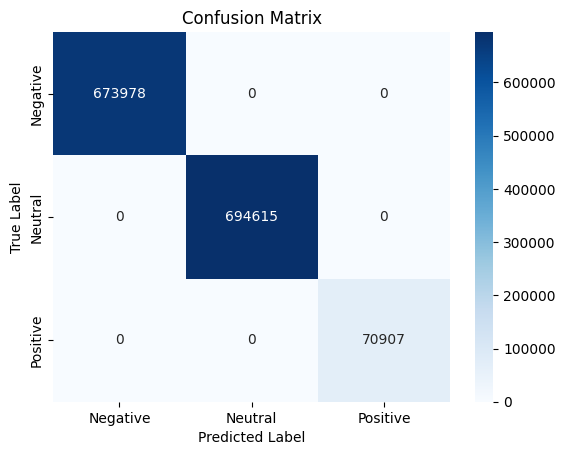

In [18]:


conf_matrix = confusion_matrix(sentiment_output['sentiment_label'], sentiment_output['predicted_sentiment_label'])
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Negative', 'Neutral', 'Positive'],
            yticklabels=['Negative', 'Neutral', 'Positive'])
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.title('Confusion Matrix')
plt.show()


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



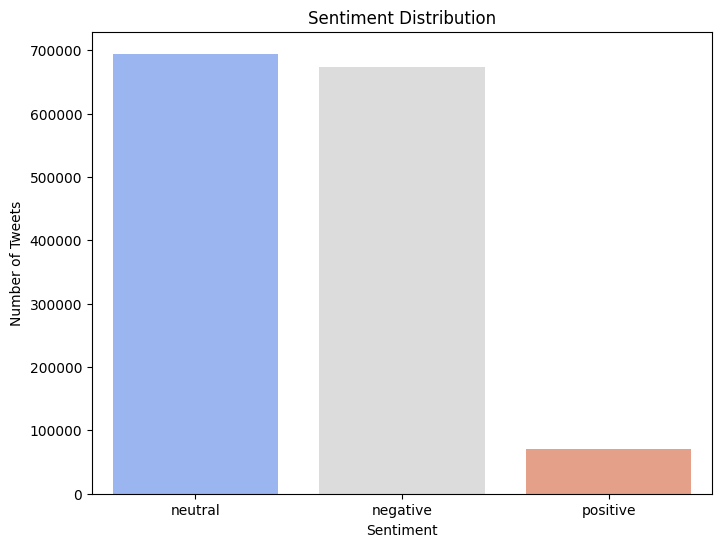

In [19]:
sentiment_counts = sentiment_output['sentiment'].value_counts()
plt.figure(figsize=(8, 6))
sns.barplot(x=sentiment_counts.index, y=sentiment_counts.values, palette="coolwarm")
plt.title("Sentiment Distribution")
plt.xlabel("Sentiment")
plt.ylabel("Number of Tweets")
plt.show()



/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



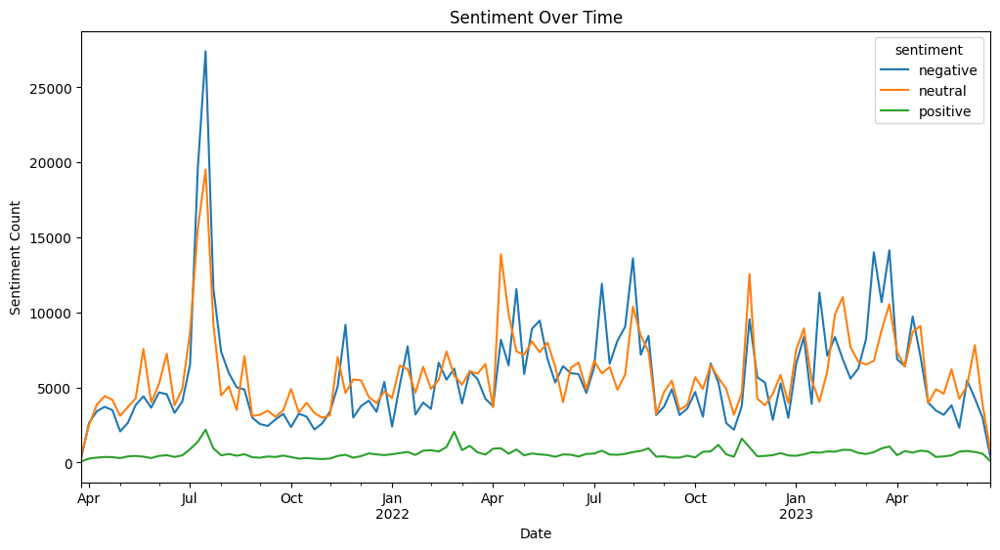

In [20]:
sentiment_output['created_at'] = pd.to_datetime(sentiment_output['created_at'])
sentiment_output.set_index('created_at', inplace=True)
sentiment_over_time = sentiment_output.resample('W')['sentiment'].value_counts().unstack()
sentiment_over_time.plot(kind='line', figsize=(12, 6))
plt.title("Sentiment Over Time")
plt.xlabel("Date")
plt.ylabel("Sentiment Count")
plt.show()

In [21]:
subset_tweets = data_en.sample(n=100000, random_state=18014519)

# Extract Locations from Text and Geocode
def extract_location_and_geocode(text):
    doc = nlp(text)
    locations = [ent.text for ent in doc.ents if ent.label_ == "GPE"]
    if locations:
        for location in locations:
            try:
                geo_info = geolocator.geocode(location, timeout=10)  # Set a timeout
                if geo_info:
                    return geo_info.latitude, geo_info.longitude, location
            except Exception as e:
                print(f"Error geocoding {location}: {e}")
                continue
    return None, None, None

subset_tweets[['latitude', 'longitude', 'extracted_location']] = subset_tweets['text_clean'].progress_apply(
    lambda x: pd.Series(extract_location_and_geocode(x))
)

subset_tweets.to_parquet('/content/drive/My Drive/sapoliceservice_subset_with_locations_1.parquet')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

100%|██████████| 100000/100000 [1:14:54<00:00, 22.25it/s]


In [3]:
!pip install folium
import folium
import pandas as pd

geolocation_output = pd.read_parquet('/content/drive/My Drive/sapoliceservice_subset_with_locations_1.parquet')


m = folium.Map(location=[-30.5595, 22.9375], zoom_start=5)

for _, row in geolocation_output.dropna(subset=['latitude', 'longitude']).iterrows():
    folium.Marker([row['latitude'], row['longitude']], popup=row['extracted_location']).add_to(m)

m.save("geolocation_map.html")
m

In [7]:
!pip list

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Package                            Version
---------------------------------- -------------------
absl-py                            1.4.0
accelerate                         1.1.1
aiohappyeyeballs                   2.4.3
aiohttp                            3.10.10
aiosignal                          1.3.1
alabaster                          1.0.0
albucore                           0.0.19
albumentations                     1.4.20
altair                             4.2.2
annotated-types                    0.7.0
anyascii                           0.3.2
anyio                              3.7.1
argon2-cffi                        23.1.0
argon2-cffi-bindings               21.2.0
array_record                       0.5.1
arviz                              0.20.0
astropy                            6.1.5
astropy-iers-data                  0.2024.11.4.0.33.34
astunparse                         1.6.3
async-timeout                      4.0.3
atpublic                           4.1.0
attrs               